In [69]:
from google.colab import drive 
drive.mount('/content/gdrive') 

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [70]:
file_name = "/content/gdrive/My Drive/Dataset"

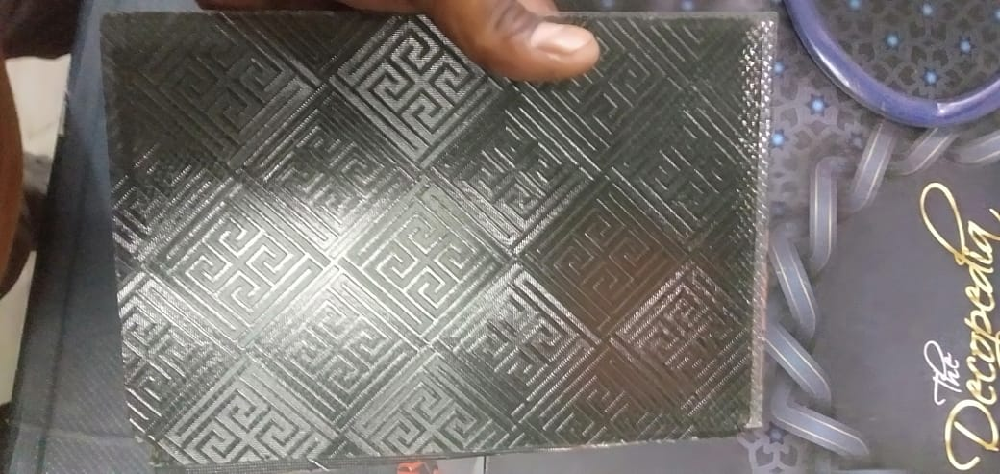

In [71]:
import cv2

img = cv2.imread('/content/1.jpg', -1)
from google.colab.patches import cv2_imshow
cv2_imshow(img)

In [72]:
img.shape

(493, 1040, 3)

# Import libraries

In [73]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
%matplotlib inline
from glob import glob
import cv2, os
import keras
from tensorflow.keras.utils import load_img, img_to_array, array_to_img

# Dataset loading

In [74]:
path = '/content/gdrive/My Drive/Dataset/'
img_dataset = []

In [75]:
def load_img():
    img_path = os.path.join(path, "*")
    print(img_path)
    for i in glob(img_path):
        img  = cv2.imread(i)
        #data = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        data = cv2.resize(img, (512, 512))
        data = img_to_array(data)
        img_dataset.append(data)
    print('All images loaded')

load_img()

/content/gdrive/My Drive/Dataset/*
All images loaded


In [76]:
print('Number of the Images: {}'.format(len(img_dataset)))

Number of the Images: 186


In [77]:
img_dataset[0].shape

(512, 512, 3)

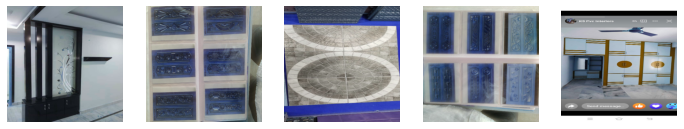

In [78]:
import random

plt.figure(figsize=(12,8))

for i in range(5):
    plt.subplot(1, 5, i+1)
    img = array_to_img(random.choice(img_dataset))
    plt.imshow(img)
    plt.axis('off')
    
plt.show()

# Split the data into train and test

In [79]:
split = round(len(img_dataset) * 0.80)

X_train =img_dataset[:split]
X_test  =img_dataset[split:]

len(X_train) ,len(X_test)

(149, 37)

# Preprocessing for autoencoder

In [80]:
X_train = np.asarray(X_train) / 255
X_test = np.asarray(X_test) / 255

print(X_train.shape, X_test.shape)

X_train = np.reshape(X_train, (len(X_train), 512, 512, 3))
X_test = np.reshape(X_test, (len(X_test), 512, 512, 3))

(149, 512, 512, 3) (37, 512, 512, 3)


# Creating autoencoder

In [81]:
input_img = Input(shape=(512,512,3))
x = Conv2D(32,(3,3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2,2), padding='same')(x)
x = Conv2D(16,(3,3), activation='relu', padding='same')(x)
x = MaxPooling2D((2,2), padding='same')(x)
x = Conv2D(8,(3,3), activation='relu', padding='same')(x)
x = MaxPooling2D((2,2), padding='same')(x)
x = Conv2D(4,(3,3), activation='relu', padding='same')(x)
x = MaxPooling2D((2,2), padding='same')(x)
x = Conv2D(2,(3,3), activation='relu', padding='same')(x)
encoded = MaxPooling2D((2,2), padding='same', name='encoder')(x)

x = Conv2D(2, (3, 3), activation='relu', padding='same')(encoded)
x = UpSampling2D((2, 2))(x)
x = Conv2D(4, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(32, (3, 3), activation='relu',  padding='same')(x)
x = UpSampling2D((2, 2))(x)
decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

autoencoder = Model(input_img, decoded)

In [82]:
autoencoder.compile(optimizer='adagrad', loss='mse')

In [83]:
autoencoder.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 512, 512, 3)]     0         
                                                                 
 conv2d_22 (Conv2D)          (None, 512, 512, 32)      896       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 256, 256, 32)     0         
 2D)                                                             
                                                                 
 conv2d_23 (Conv2D)          (None, 256, 256, 16)      4624      
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 128, 128, 16)     0         
 2D)                                                             
                                                                 
 conv2d_24 (Conv2D)          (None, 128, 128, 8)       1160

# Training the model

In [84]:
autoencoder.fit(X_train, X_train, epochs=10, batch_size=16, callbacks=None )

Epoch 1/10
10/10 [==============================] - 112s 11s/step - loss: 0.0595
Epoch 2/10
10/10 [==============================] - 97s 10s/step - loss: 0.0595
Epoch 3/10
10/10 [==============================] - 103s 10s/step - loss: 0.0595
Epoch 4/10
10/10 [==============================] - 99s 10s/step - loss: 0.0595
Epoch 5/10
10/10 [==============================] - 101s 10s/step - loss: 0.0595
Epoch 6/10
10/10 [==============================] - 101s 10s/step - loss: 0.0595
Epoch 7/10
10/10 [==============================] - 100s 10s/step - loss: 0.0595
Epoch 8/10
10/10 [==============================] - 103s 10s/step - loss: 0.0595
Epoch 9/10
10/10 [==============================] - 99s 10s/step - loss: 0.0595
Epoch 10/10
10/10 [==============================] - 103s 10s/step - loss: 0.0595


In [85]:
autoencoder.save('autoencoder.h5')

# Create the encoder part

To encode input image into a latent space representation. Dimension of representation = 16 x 16 x 2

In [86]:
autoencoder = load_model('/content/autoencoder.h5')

In [87]:
encoder = Model(inputs=autoencoder.input, outputs=autoencoder.get_layer('encoder').output)

In [88]:
encoder.save('encoder.h5')

In [89]:
encoder = load_model('/content/encoder.h5')

# Load, encode the test images and find KNN

1/1 [==============================] - 0s 81ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


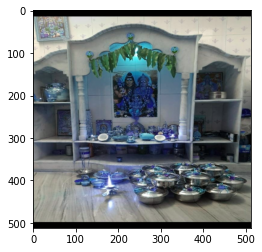

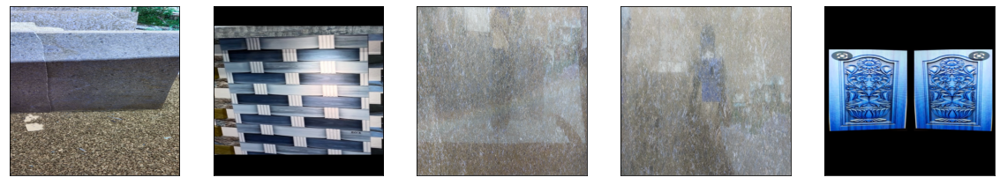

1/1 [==============================] - 0s 90ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


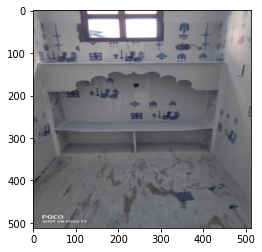

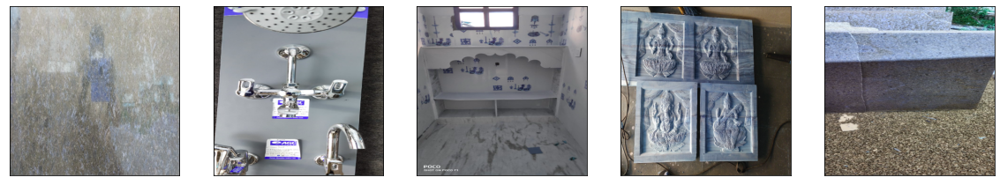

1/1 [==============================] - 0s 82ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


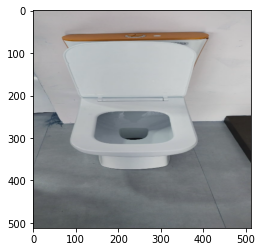

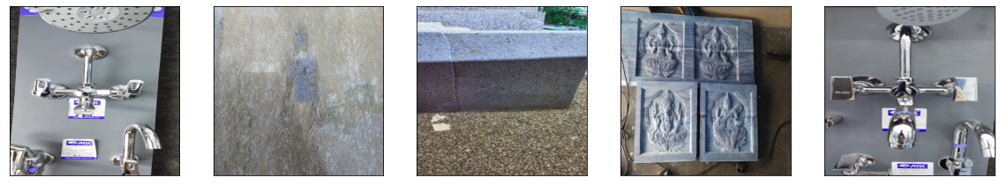

1/1 [==============================] - 0s 81ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


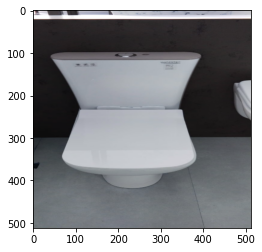

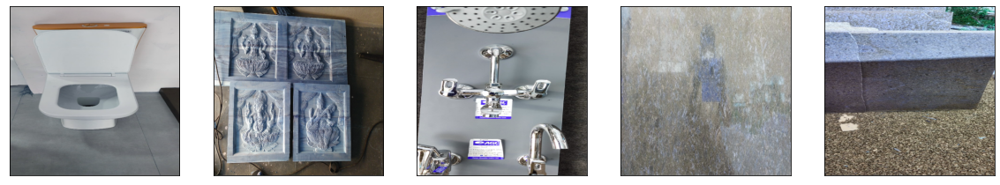

1/1 [==============================] - 0s 91ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


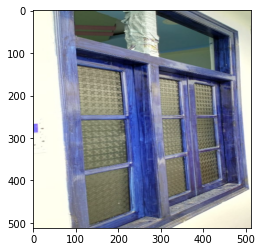

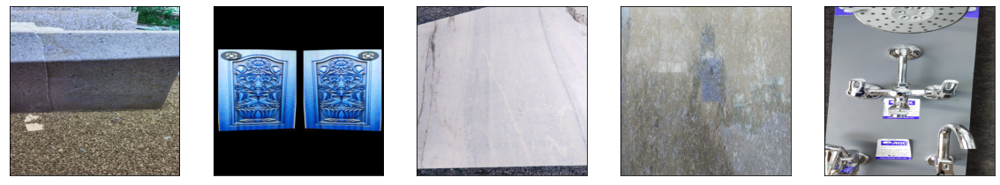

1/1 [==============================] - 0s 85ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


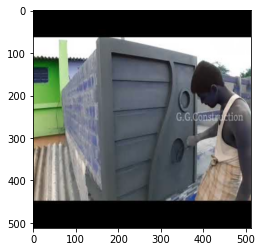

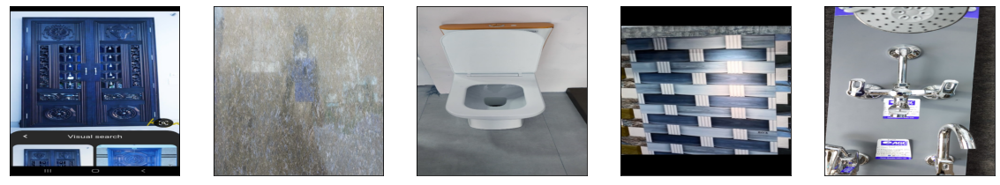

1/1 [==============================] - 0s 89ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


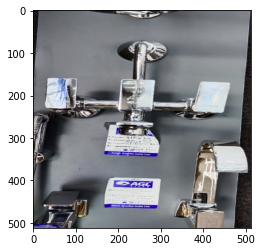

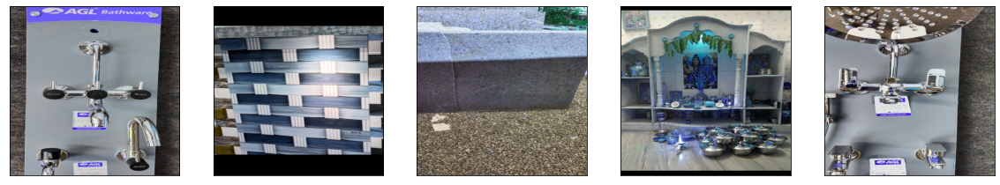

1/1 [==============================] - 0s 84ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


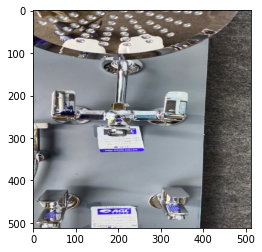

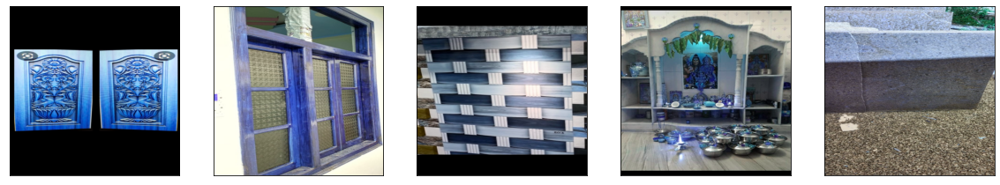

1/1 [==============================] - 0s 80ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


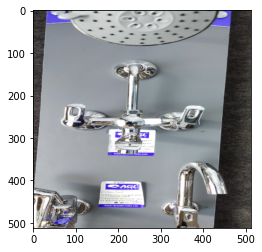

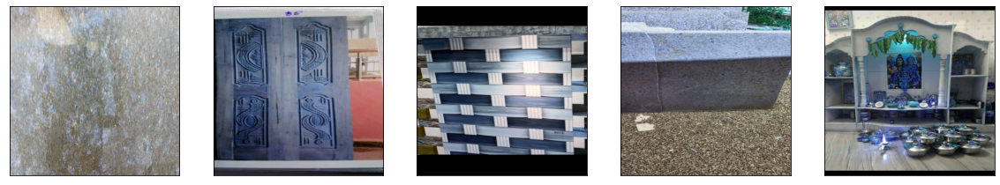

1/1 [==============================] - 0s 82ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


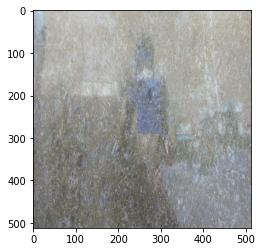

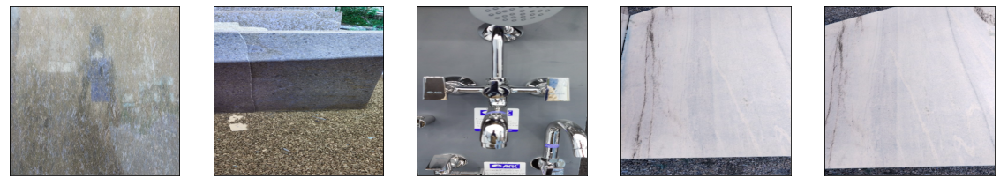

1/1 [==============================] - 0s 82ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


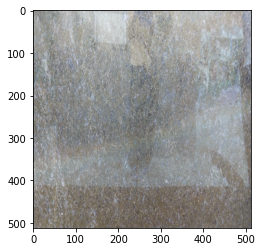

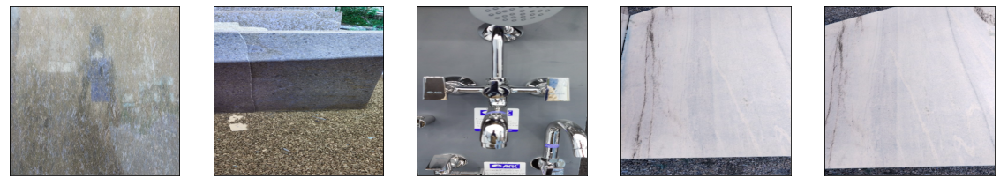

1/1 [==============================] - 0s 98ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


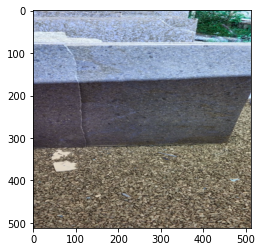

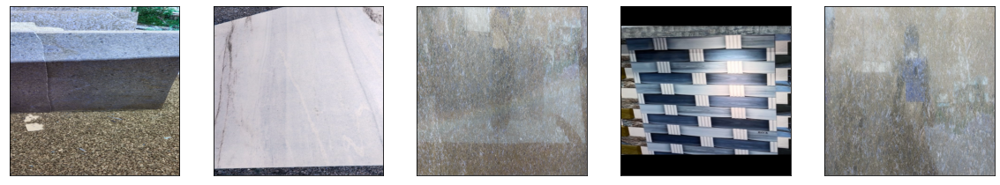

1/1 [==============================] - 0s 128ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


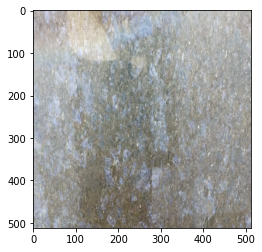

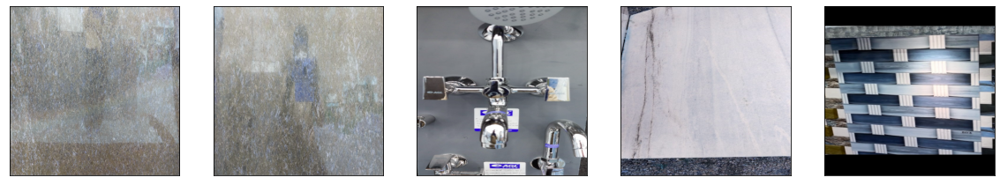

1/1 [==============================] - 0s 84ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


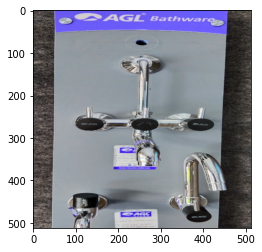

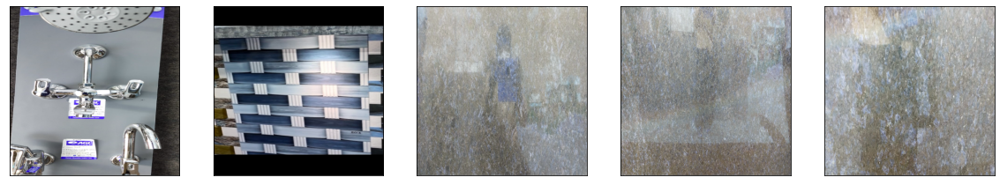

1/1 [==============================] - 0s 138ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


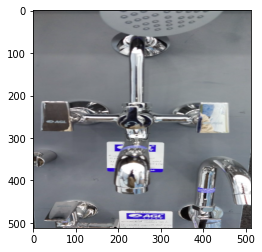

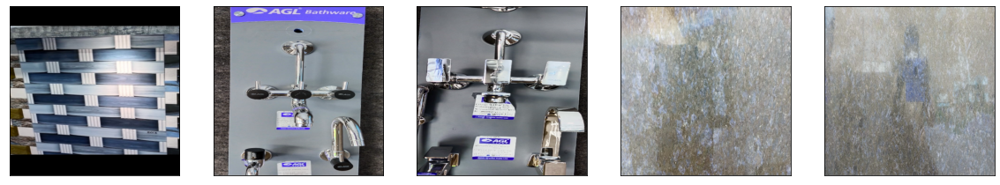

1/1 [==============================] - 0s 84ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


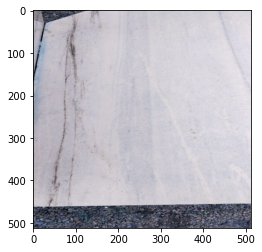

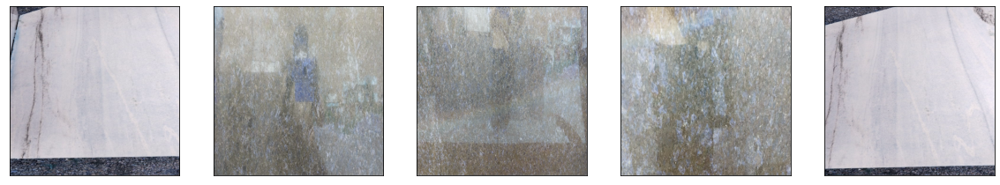

1/1 [==============================] - 0s 158ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


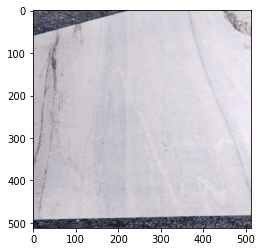

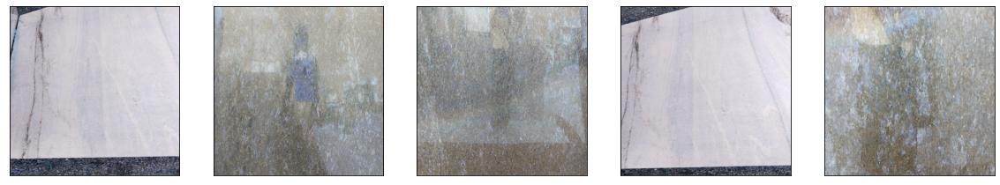

1/1 [==============================] - 0s 146ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


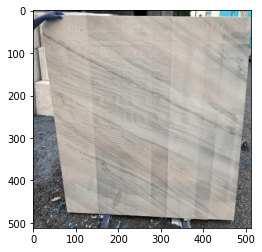

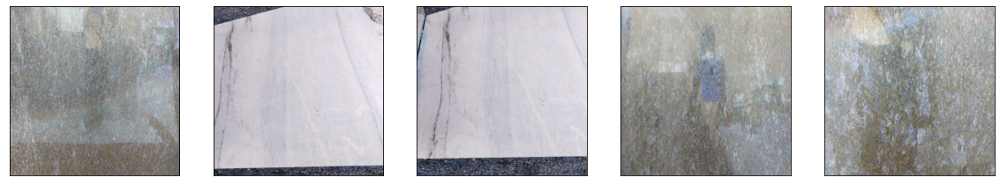

1/1 [==============================] - 0s 82ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


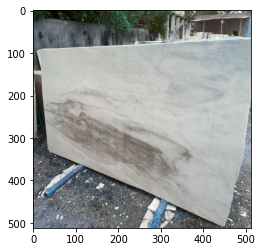

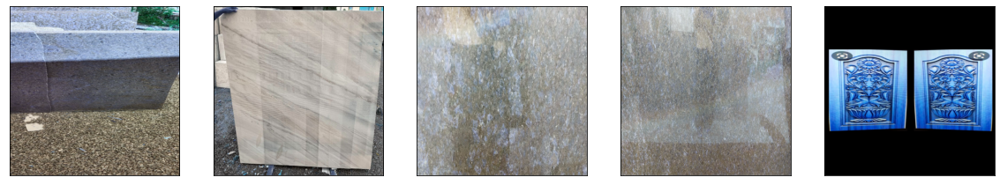

1/1 [==============================] - 0s 134ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


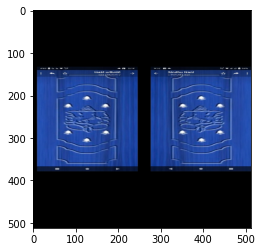

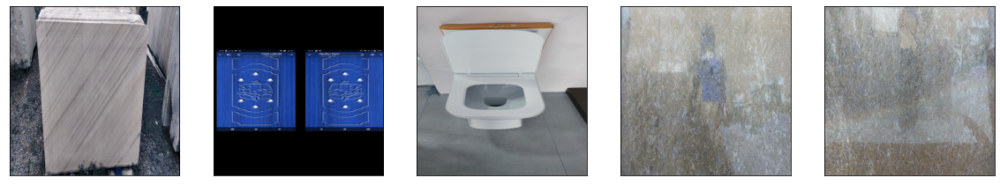

1/1 [==============================] - 0s 82ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


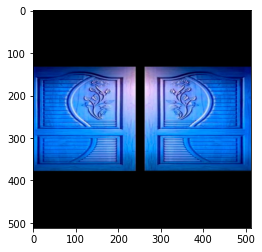

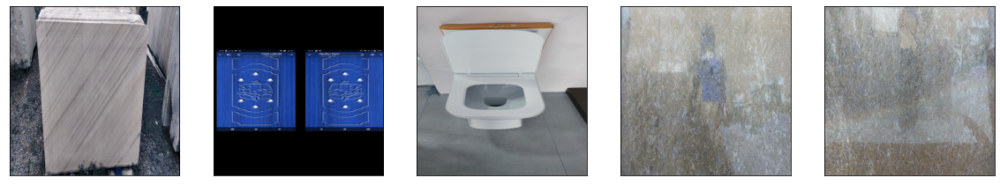

1/1 [==============================] - 0s 82ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


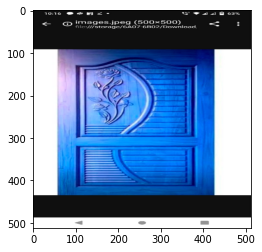

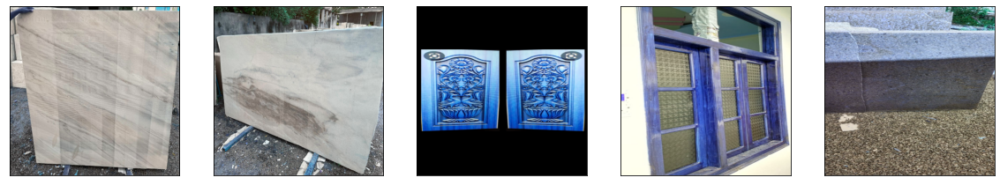

1/1 [==============================] - 0s 89ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


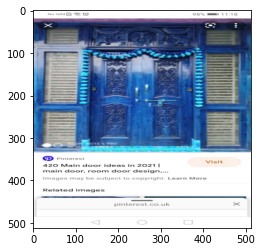

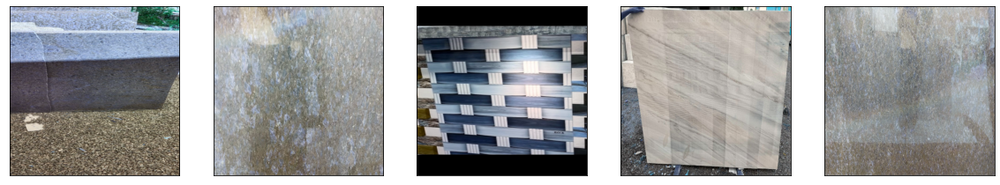

1/1 [==============================] - 0s 92ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


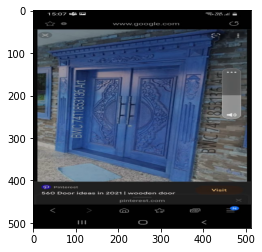

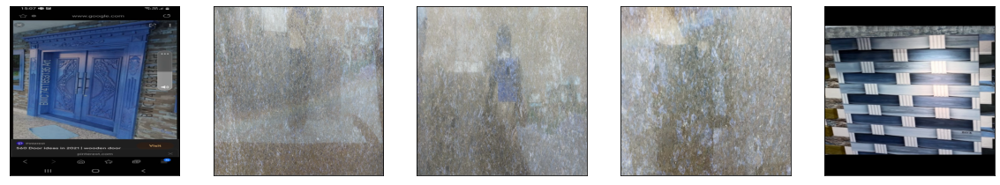

1/1 [==============================] - 0s 126ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


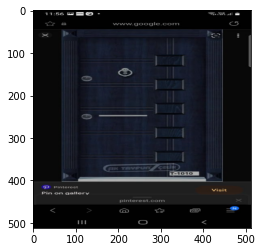

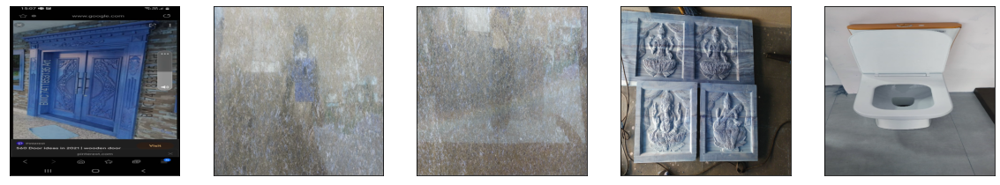

1/1 [==============================] - 0s 81ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


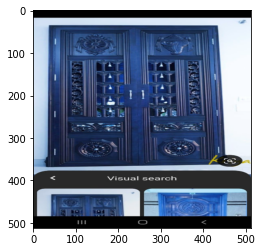

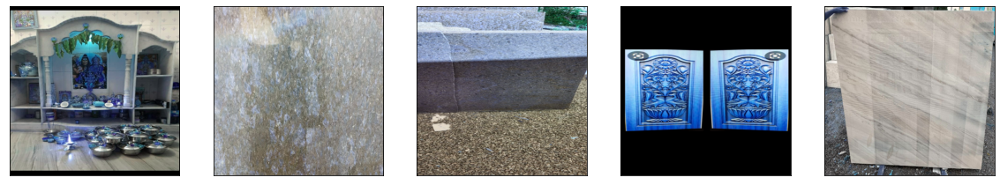

1/1 [==============================] - 0s 115ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


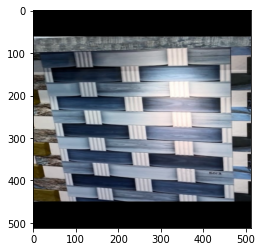

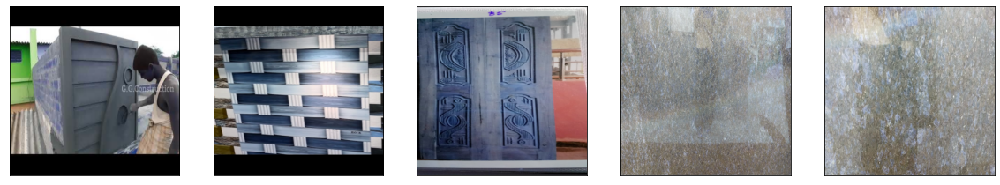

1/1 [==============================] - 0s 160ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


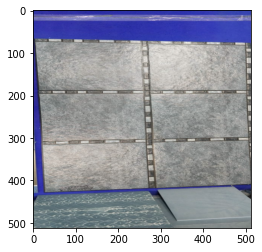

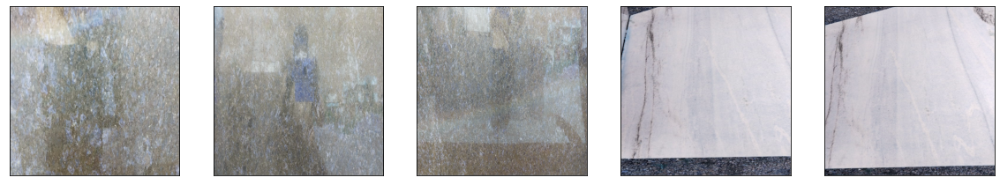

1/1 [==============================] - 0s 146ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


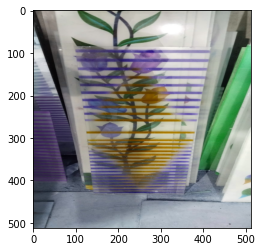

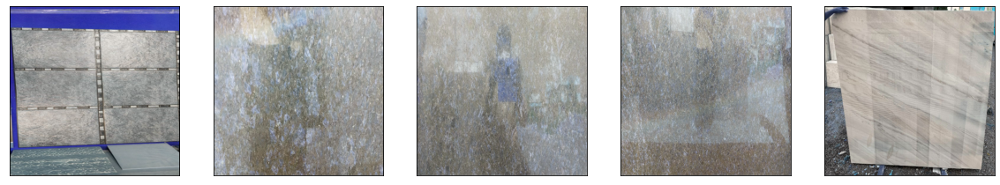

1/1 [==============================] - 0s 122ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


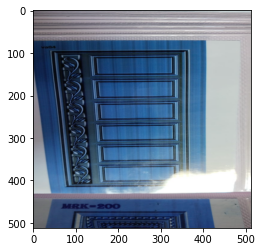

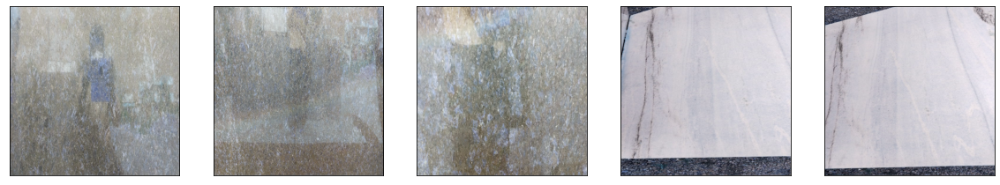

1/1 [==============================] - 0s 146ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


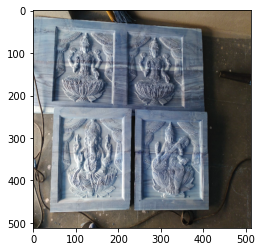

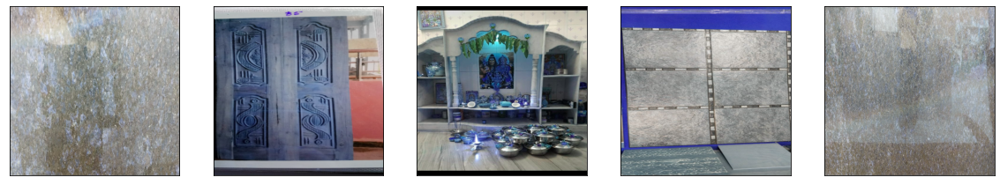

1/1 [==============================] - 0s 147ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


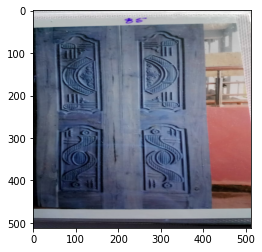

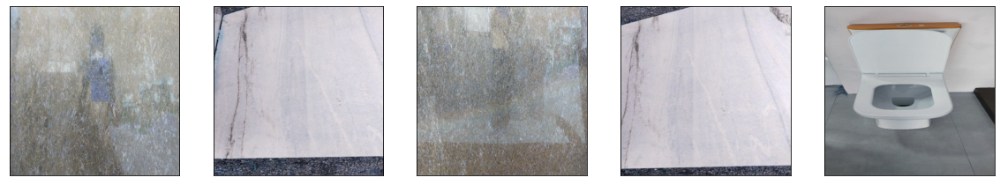

1/1 [==============================] - 0s 145ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


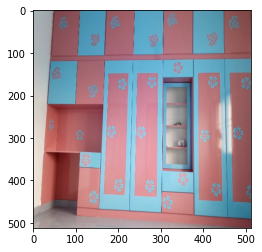

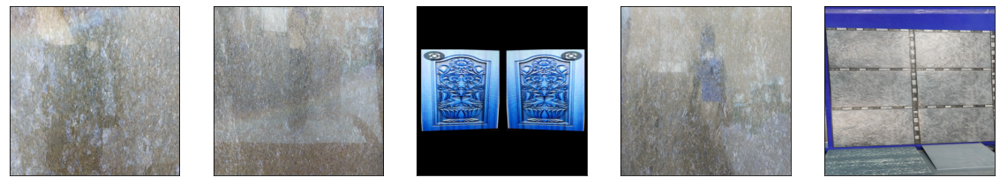

1/1 [==============================] - 0s 83ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


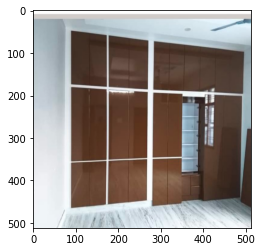

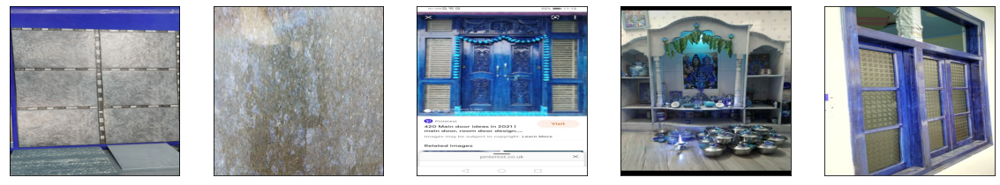

1/1 [==============================] - 0s 134ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


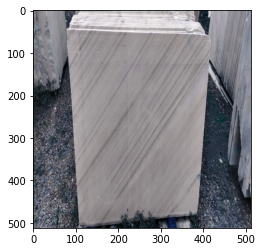

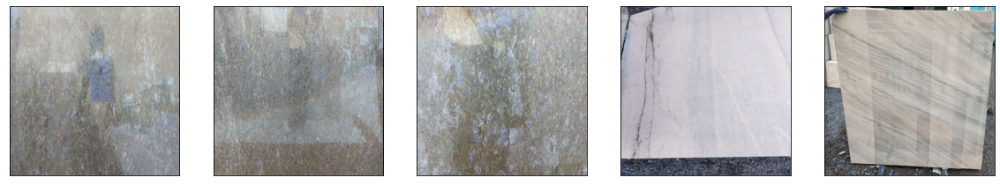

1/1 [==============================] - 0s 144ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


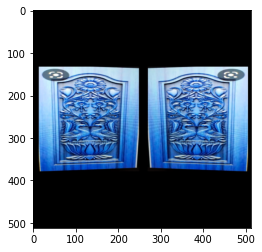

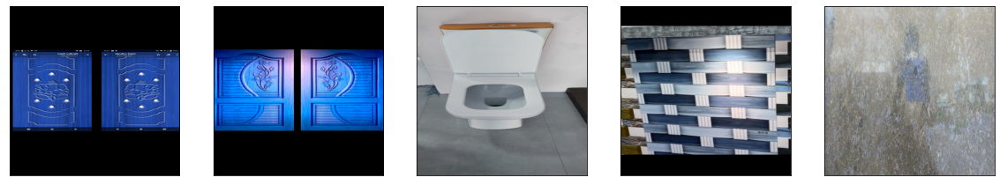

1/1 [==============================] - 0s 145ms/step
512
(36, 512)
(1, 512)
(5, 512, 512, 3)


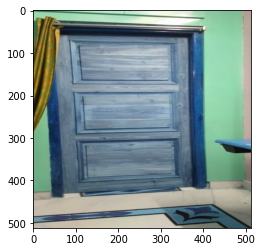

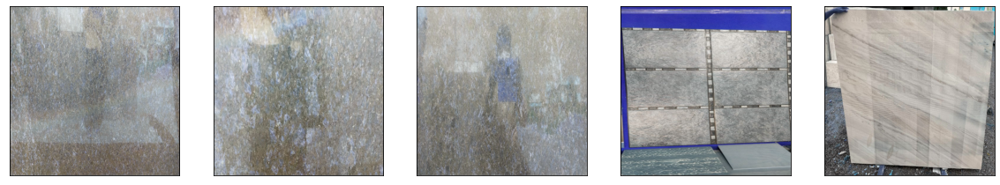

--- 143.22008633613586 seconds ---
Mean absolute square error  [0.40861365 0.48359814 0.5307085  0.5585651  0.58243555]


In [90]:
from sklearn.neighbors import NearestNeighbors
import time

start_time = time.time()
mase = 0.0

n = len(X_test)

for i in range(n):
    query = X_test[i]
    plt.imshow(query.reshape(512,512,3));
    X_test1 = np.delete(X_test, i, axis=0)
    X_test1.shape
    code = encoder.predict(X_test1)
    query_code = encoder.predict(query.reshape(1,512,512,3))
    code.shape
    query_code.shape
    a=1
    for i in query_code[0].shape:
      a = a*i
    print(a)

    n_neigh = 5
    code = code.reshape(-1, a)
    print(code.shape)

    query_code = query_code.reshape(1, a)
    print(query_code.shape)

    nbrs = NearestNeighbors(n_neighbors=n_neigh).fit(code)
    distances, indices = nbrs.kneighbors(np.array(query_code))

    sum = 0
    for distance in distances:
        sum += distance

    avg_dis = sum / len(distances)
    mase = mase + avg_dis*avg_dis

    closest_images = X_test[indices]
    closest_images = closest_images.reshape(-1,512,512,3)
    print(closest_images.shape)
    plt.figure(figsize=(20, 6))
    for i in range(n_neigh):
        # display original
        ax = plt.subplot(1, n_neigh, i+1)
        plt.imshow(closest_images[i].reshape(512, 512, 3))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        
    plt.show()

error = mase/len(X_test)
print("--- %s seconds ---" % (time.time() - start_time))
print("Mean absolute square error ", error)